In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Data Processing

We are going to assume that the data is a mobile GPS data.

In [2]:
#load the dataset from the website
#df=pd.read_csv("https://gps-london.s3.eu-west-2.amazonaws.com/gps.csv")

#or you can download the dataset and load it directly into a variable
df=pd.read_csv("gps.csv")

In [3]:
#look at the preview of the data
df.head()

,user_id,datetime,lat,lon
0,00F70625-4B30-4B4F-A0E3-A5CD9474E34F,2018-01-09 08:49:29+00:00,51.504017,-0.086455
1,00F70625-4B30-4B4F-A0E3-A5CD9474E34F,2018-01-09 08:52:01+00:00,51.505192,-0.090741
2,00F70625-4B30-4B4F-A0E3-A5CD9474E34F,2018-01-09 08:52:32+00:00,51.504098,-0.095321
3,00F70625-4B30-4B4F-A0E3-A5CD9474E34F,2018-01-09 08:55:55+00:00,51.504084,-0.109144
4,00F70625-4B30-4B4F-A0E3-A5CD9474E34F,2018-01-09 08:58:01+00:00,51.504191,-0.113367


In [4]:
# Check how many records there are
df.shape

(1770011, 4)

In [5]:
# Check if there is missing values for each column
df.isnull().sum()

user_id     0
datetime    0
lat         0
lon         0
dtype: int64

In [6]:
# Check the statistical info of the lat and lon data
df.describe()

,lat,lon
count,1.770011e+06,1.770011e+06
mean,5.149896e+01,-9.836186e-02
std,6.002999e-03,1.186196e-02
min,5.148249e+01,-1.213403e-01
25%,5.149463e+01,-1.088844e-01
50%,5.150077e+01,-9.862888e-02
75%,5.150407e+01,-8.793030e-02
max,5.150664e+01,-7.640790e-02


In [7]:
# Look for the info of the data set
df.nunique()

user_id       31606
datetime     611899
lat         1431187
lon         1509745
dtype: int64

Based on the data above, we can see that the data consists of 31606 different users. With such numbers, it will consume a lot of computer power. 
To analyse the dwell further, we need to be able to analyse the time 

In [8]:
df['datetime'] = pd.to_datetime(df['datetime'])

# Extract the day of the week (where Monday=0, Sunday=6) and find unique values
print("The days recorded are: " + str(sorted(df['datetime'].dt.weekday.unique())))

print("The earliest date in the data is "+str(df['datetime'].dt.date.unique().min())+" and the latest date in the data is "+str(df['datetime'].dt.date.unique().max()))

The days recorded are: [0, 1, 2, 3, 4]
The earliest date in the data is 2018-01-08 and the latest date in the data is 2018-01-19


It shows that the data only consists of weekdays (Monday - Friday) and it consists of GPS data on that specific range of data.

In [9]:
# Scale down the dataset based on unique user_id
# Since each user has different number of records
# We're going to take 1000 users with the most record to be analysed
groupby=df.groupby('user_id').size().sort_values(ascending=False).reset_index()[:1000]
smaller_df=df[df['user_id'].isin(groupby['user_id'])].reset_index(drop=True)
smaller_df

,user_id,datetime,lat,lon
0,00464451-505E-41BA-9180-13D271A17563,2018-01-08 07:21:34+00:00,51.493308,-0.099937
1,00464451-505E-41BA-9180-13D271A17563,2018-01-08 07:23:06+00:00,51.494433,-0.100668
2,00464451-505E-41BA-9180-13D271A17563,2018-01-08 07:25:28+00:00,51.497213,-0.107263
3,00464451-505E-41BA-9180-13D271A17563,2018-01-08 07:26:52+00:00,51.498527,-0.111880
4,00464451-505E-41BA-9180-13D271A17563,2018-01-08 07:28:40+00:00,51.500680,-0.117262
...,...,...,...,...
265000,fd11a795-331a-4004-8d91-1786dba214fd,2018-01-19 16:13:28+00:00,51.500749,-0.094187
265001,fd11a795-331a-4004-8d91-1786dba214fd,2018-01-19 16:14:16+00:00,51.500749,-0.094187
265002,fd11a795-331a-4004-8d91-1786dba214fd,2018-01-19 16:23:11+00:00,51.493721,-0.098600
265003,fd11a795-331a-4004-8d91-1786dba214fd,2018-01-19 16:26:21+00:00,51.494571,-0.099436


In [10]:
# Here we want to analyse the time pattern
from datetime import datetime

# Function to convert datetime string to day of week
def classify_timeofday(datetime_data):
    if datetime_data.time() >= pd.to_datetime('05:00:00').time() and datetime_data.time() < pd.to_datetime('12:00:00').time():
        return 'Morning'
    elif datetime_data.time() >= pd.to_datetime('12:00:00').time() and datetime_data.time() < pd.to_datetime('17:00:00').time():
        return 'Afternoon'
    elif datetime_data.time() >= pd.to_datetime('17:00:00').time() and datetime_data.time() < pd.to_datetime('21:00:00').time():
        return 'Evening'
    else:
        return 'Night'

In [ ]:
# Apply the functions to the 'datetime' column to create new columns for date and time
# This will take quite a long time
smaller_df['date'] = smaller_df['datetime'].dt.date
smaller_df['time'] = smaller_df['datetime'].dt.time
smaller_df['day_of_week'] = smaller_df['datetime'].dt.weekday
smaller_df['time_of_day'] = smaller_df['datetime'].apply(classify_timeofday)

In [295]:
# Save the file in case you want to rerun it again
# This is so that you do not have to run the previous functions again and save more time.
# smaller_df.to_csv('smaller_df.csv)

## 2. Data Exploration

We want to see the how the data is scattered around London. Since the record shows that it consists of 1.7 Millions, instead of plotting them one by one, we can try to plot the corner points of the data.

In order to do this, we can obtain min and max of both longitude and latitude and plot them on the map.

In [13]:
# Load the dataset with fewer records
# smaller_df=pd.read_csv('smaller_df.csv')

In [28]:
smaller_df['datetime']=pd.to_datetime(smaller_df['datetime'])
smaller_df.head()

,Unnamed: 0,user_id,datetime,lat,lon,date,time,day_of_week,time_of_day
0,766,00322F75-C379-4499-A44C-E8ABBC4AB428,2018-01-08 07:07:10+00:00,51.487436,-0.095510,2018-01-08,07:07:10,0,Morning
1,767,00322F75-C379-4499-A44C-E8ABBC4AB428,2018-01-08 07:11:05+00:00,51.494641,-0.100943,2018-01-08,07:11:05,0,Morning
2,768,00322F75-C379-4499-A44C-E8ABBC4AB428,2018-01-08 07:13:28+00:00,51.497119,-0.102698,2018-01-08,07:13:28,0,Morning
3,769,00322F75-C379-4499-A44C-E8ABBC4AB428,2018-01-08 07:21:38+00:00,51.499483,-0.103714,2018-01-08,07:21:38,0,Morning
4,770,00322F75-C379-4499-A44C-E8ABBC4AB428,2018-01-08 09:41:03+00:00,51.499783,-0.100031,2018-01-08,09:41:03,0,Morning


### 2.1. In which area is the data's gps on?

Since we just want to look at the range of the whole data, we can analyse it from df instead of smaller_df

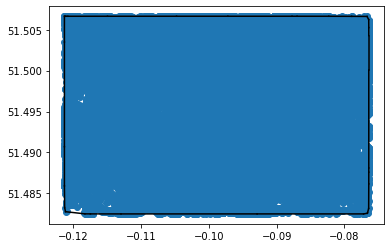

In [15]:
from scipy.spatial import ConvexHull

# Create the points from lon and lat
points = df[['lon', 'lat']].values

# Compute the Convex Hull
hull = ConvexHull(points)

# Plotting the Convex Hull
plt.plot(points[:, 0], points[:, 1], 'o')  # Plot the points
for simplex in hull.simplices:
    plt.plot(points[simplex, 0], points[simplex, 1], 'k-')  # Plot the hull

plt.show()


In [16]:
import folium

# Calculate the minimum and maximum latitude and longitude
min_lat, max_lat = df['lat'].min(), df['lat'].max()
min_lon, max_lon = df['lon'].min(), df['lon'].max()

# Create a map centered around the average coordinates
m = folium.Map(location=[(min_lat + max_lat) / 2, 
                         (min_lon + max_lon) / 2], 
               zoom_start=13,
               width='100%',
               height='80%')

# Define the four corner points
corner_points = {
    'Min Lat, Min Lon': (min_lat, min_lon),
    'Min Lat, Max Lon': (min_lat, max_lon),
    'Max Lat, Max Lon': (max_lat, max_lon),
    'Max Lat, Min Lon': (max_lat, min_lon)
}

# Add markers for each corner point
for point_label, (lat, lon) in corner_points.items():
    folium.Marker(
        location=[lat, lon],
        popup=point_label,
        icon=folium.Icon(color='red', icon='info-sign')
    ).add_to(m)

# Display map
m


Based on those points, it shows that the gps data are scattered in the South of London area.

### 2.2. Is there any specific pattern on day of the week or time of day of the GPS records?

In [18]:
pattern_analysis = smaller_df.groupby(['user_id', 'day_of_week', 'time_of_day']).size().reset_index(name='counts')
pattern_analysis

,user_id,day_of_week,time_of_day,counts
0,00322F75-C379-4499-A44C-E8ABBC4AB428,0,Afternoon,42
1,00322F75-C379-4499-A44C-E8ABBC4AB428,0,Evening,10
2,00322F75-C379-4499-A44C-E8ABBC4AB428,0,Morning,39
3,00322F75-C379-4499-A44C-E8ABBC4AB428,1,Afternoon,25
4,00322F75-C379-4499-A44C-E8ABBC4AB428,1,Evening,11
...,...,...,...,...
12665,fd6cfc13-6712-440f-a3cf-62fe086ee100,2,Afternoon,67
12666,fd6cfc13-6712-440f-a3cf-62fe086ee100,2,Morning,25
12667,fd6cfc13-6712-440f-a3cf-62fe086ee100,3,Afternoon,23
12668,fd6cfc13-6712-440f-a3cf-62fe086ee100,3,Morning,27


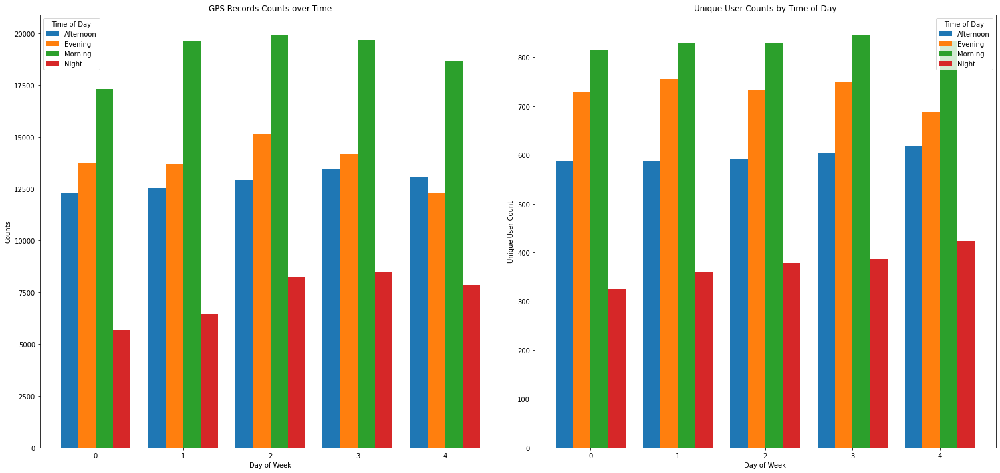

In [19]:
# Create a figure and a set of subplots with 1 row and 2 columns for the GPS Record
fig, axes = plt.subplots(1, 2, figsize=(21, 10))

# First plot: stacked bar chart
# Pivot the data for plotting
pivot_data = pattern_analysis.pivot_table(index='day_of_week', columns='time_of_day', values='counts', aggfunc='sum', fill_value=0)

# Define the x locations for the groups
day_of_week = pivot_data.index
n_time_of_day = len(pivot_data.columns)
ind = np.arange(len(day_of_week))
width = 0.2  

# Generate bars for each time_of_day category
for i, time_of_day in enumerate(pivot_data.columns):
    axes[0].bar(ind + i*width, pivot_data[time_of_day], width, label=time_of_day)

# Customize the first plot
axes[0].set_xlabel('Day of Week')
axes[0].set_ylabel('Counts')
axes[0].set_title('GPS Records Counts over Time')
axes[0].set_xticks(ind + width * (n_time_of_day / 2) - width / 2)
axes[0].set_xticklabels(day_of_week)
axes[0].legend(title='Time of Day')

# Second plot: stacked bar chart for unique user's
unique_user_counts = smaller_df.groupby(['day_of_week','time_of_day'])['user_id'].nunique().reset_index(name='unique_users')
pivot_data = unique_user_counts.pivot(index='day_of_week', columns='time_of_day', values='unique_users')

for i, time_of_day in enumerate(pivot_data.columns):
    axes[1].bar(ind + i*width, pivot_data[time_of_day], width, label=time_of_day)

axes[1].set_xlabel('Day of Week')
axes[1].set_ylabel('Unique User Count')
axes[1].set_title('Unique User Counts by Time of Day')
axes[1].set_xticks(ind + width * (n_time_of_day / 2) - width / 2)
axes[1].set_xticklabels(day_of_week)
axes[1].legend(title='Time of Day')

# Adjust the layout so the plots are next to each other
plt.tight_layout()
plt.suptitle('')

# Show the plots
plt.show()

The first graph depicts the distribution of the GPS data across the week while the second one shows the distribution of the user counts for each day. Both graphs show similar patterns across the weekdays, both in terms of records and number of users. As for the day of week, Monday has the lowest count of records out of five days. 

### 2.3. Is there any dwelling pattern in the data?

To be able to identify any dwelling pattern, the parameters should be set beforehand. In this case, we can define "the dwelling" criteria. In order to be considered dwelling, a user needs to stay within a certain area in a specific amount of duration continuously. For this project, we can set the buffer area to be in the radius of 50 meters with a minimum duration of 1 hour.

In [62]:
# Make a function to measure the buffer area and standardise the unit of measurement
def measure_distance(lat1, lon1, lat2, lon2):
    # Radius of the Earth in km
    R = 6371.0
    # Convert degrees to radians
    lat1_rad = np.radians(lat1)
    lon1_rad = np.radians(lon1)
    lat2_rad = np.radians(lat2)
    lon2_rad = np.radians(lon2)
    # Differences in coordinates
    dlat = lat2_rad - lat1_rad
    dlon = lon2_rad - lon1_rad
    # Haversine formula
    a = np.sin(dlat / 2)**2 + np.cos(lat1_rad) * np.cos(lat2_rad) * np.sin(dlon / 2)**2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))
    distance = R * c
    return distance

# Make a function to identify dwell with a minimum duration of 60 minutes and within 50 meters.
def identify_dwells(user_data, min_duration_minutes=60, radius_km=0.05): #We can adjust the parameters based on what we want
    dwells = []
    current_dwell = [user_data.iloc[0]]
    for i in range(1, len(user_data)):
        prev_point = user_data.iloc[i-1]
        curr_point = user_data.iloc[i]
        # Calculate time difference and distance between current and previous point
        time_diff = (curr_point['datetime'] - prev_point['datetime']).total_seconds() / 60
        distance = measure_distance(prev_point['lat'], prev_point['lon'], curr_point['lat'], curr_point['lon'])
        # If within radius, add to current dwell
        if distance <= radius_km:
            current_dwell.append(curr_point)
        else:
            # Check if current dwell duration is longer than the minimum duration
            dwell_duration = (current_dwell[-1]['datetime'] - current_dwell[0]['datetime']).total_seconds() / 60
            if dwell_duration >= min_duration_minutes:
                dwells.append(current_dwell)
            current_dwell = [curr_point]
    # Check for the last dwell
    if len(current_dwell) > 1:
        dwell_duration = (current_dwell[-1]['datetime'] - current_dwell[0]['datetime']).total_seconds() / 60
        if dwell_duration >= min_duration_minutes:
            dwells.append(current_dwell)
    return dwells

In [63]:
user_dwells_adjusted = {}

for user_id in smaller_df['user_id'].unique():
    user_data = smaller_df[smaller_df['user_id'] == user_id]
    dwells = identify_dwells(user_data)
    user_dwells_adjusted[user_id] = dwells

# Prepare a summary of the results for the adjusted criteria
summary_adjusted = [(user_id, len(dwells)) for user_id, dwells in user_dwells_adjusted.items()]

# Summarise the findings
total_dwells_found = sum([len(dwells) for dwells in user_dwells_adjusted.values()])
average_dwells_per_user = total_dwells_found / len(user_dwells_adjusted)
max_dwell_count = max(summary_adjusted, key=lambda x: x[1])[1]
min_dwell_count = min([count for _, count in summary_adjusted if count > 0])

In [64]:
print("total dwells found : "+str(total_dwells_found))
print("total users : "+str(len(smaller_df['user_id'].unique())))
print("average dwell per user : "+str(average_dwells_per_user))
print("max dwell : "+str(max_dwell_count))
print("min dwell : "+str(min_dwell_count))

total dwells found : 3190
total users : 1000
average dwell per user : 3.19
max dwell : 29
min dwell : 1


In [65]:
# Let's do the function again but with duration
def identify_dwells_with_duration(user_data, min_duration_minutes=60, radius_km=0.05):
    dwells = []
    current_dwell = [user_data.iloc[0]]
    for i in range(1, len(user_data)):
        prev_point = user_data.iloc[i-1]
        curr_point = user_data.iloc[i]
        # Calculate time difference and distance between current and previous point
        distance = measure_distance(prev_point['lat'], prev_point['lon'], curr_point['lat'], curr_point['lon'])
        # If within radius, add to current dwell
        if distance <= radius_km:
            current_dwell.append(curr_point)
        else:
            # Check if current dwell duration is longer than the minimum duration
            dwell_duration = (current_dwell[-1]['datetime'] - current_dwell[0]['datetime']).total_seconds() / 60
            if dwell_duration >= min_duration_minutes:
                dwells.append({'start': current_dwell[0]['datetime'],
                               'end': current_dwell[-1]['datetime'],
                               'duration': dwell_duration})
            current_dwell = [curr_point]
    # Check for the last dwell
    if len(current_dwell) > 1:
        dwell_duration = (current_dwell[-1]['datetime'] - current_dwell[0]['datetime']).total_seconds() / 60
        if dwell_duration >= min_duration_minutes:
            dwells.append({'start': current_dwell[0]['datetime'],
                           'end': current_dwell[-1]['datetime'],
                           'duration': dwell_duration})
    return dwells

In [66]:
smaller_df.sort_values(by=['user_id', 'datetime'], inplace=True)

# Apply the function to a subset of data for demonstration
user_dwell_durations = {}

# Calculate dwell periods and their durations for each user in the subset
for user_id in smaller_df.user_id.unique():
    user_data = smaller_df[smaller_df['user_id'] == user_id]
    dwell_durations = identify_dwells_with_duration(user_data)
    user_dwell_durations[user_id] = dwell_durations

In [67]:
first_user_id = smaller_df.user_id.unique()[0]
user_dwell_durations[first_user_id]

[{'start': Timestamp('2018-01-08 09:43:20+0000', tz='UTC'),
  'end': Timestamp('2018-01-08 11:09:51+0000', tz='UTC'),
  'duration': 86.51666666666667},
 {'start': Timestamp('2018-01-09 18:12:32+0000', tz='UTC'),
  'end': Timestamp('2018-01-10 07:06:50+0000', tz='UTC'),
  'duration': 774.3},
 {'start': Timestamp('2018-01-10 09:58:30+0000', tz='UTC'),
  'end': Timestamp('2018-01-10 11:11:21+0000', tz='UTC'),
  'duration': 72.85}]

In [68]:
all_durations=[]
# Extract durations
for user_id, dwells in user_dwell_durations.items():
    for dwell in dwells:
        all_durations.append(dwell['duration'])

# Calculate max, min, and average of the duration
max_duration = round(max(all_durations),2)
min_duration = round(min(all_durations),2)
avg_duration = round(sum(all_durations) / len(all_durations),2)

print(f"Maximum dwell duration: {max_duration} minutes or {round(max_duration/60,2)} hours" )
print(f"Minimum dwell duration: {min_duration} minutes or {round(min_duration/60,2)} hours")
print(f"Average dwell duration: {avg_duration} minutes or {round(avg_duration/60,2)} hours")

Maximum dwell duration: 16290.08 minutes or 271.5 hours
Minimum dwell duration: 60.22 minutes or 1.0 hours
Average dwell duration: 629.42 minutes or 10.49 hours


Text(0.5, 1.0, 'Dwelling Duration Distribution for 1000 Users with Most Records')

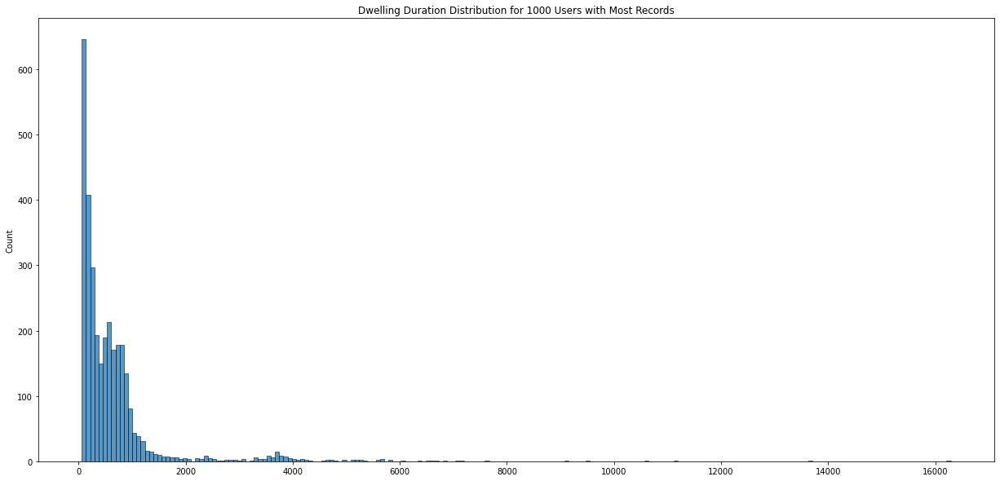

In [69]:
fig, axes = plt.subplots(figsize=(21, 10))
sns.histplot(data=all_durations)
plt.title("Dwelling Duration Distribution for 1000 Users with Most Records")

In [55]:
df2=smaller_df.copy()

def identify_dwelling_periods(user_data, min_duration_minutes=10, radius_km=0.05):
    # Initialize a boolean Series with False for the 'is_dwell' flag
    is_dwell = pd.Series([False] * len(user_data), index=user_data.index)
    # Initialize a numeric Series with 0 for the 'dwell_duration' values
    dwell_duration = pd.Series([0] * len(user_data), index=user_data.index)
    
    # Initialize variables to keep track of a potential dwell's start and end
    dwell_start_index = 0
    for i in range(1, len(user_data)):
        # Calculate distance from the current point to the previous point
        distance = measure_distance(user_data.iloc[i-1]['lat'], user_data.iloc[i-1]['lon'],
                             user_data.iloc[i]['lat'], user_data.iloc[i]['lon'])
        
        # If the distance is greater than the radius, check if the current segment is a dwell
        if distance > radius_km:
            # Calculate the duration of the current segment
            segment_duration = (user_data.iloc[i-1]['datetime'] - user_data.iloc[dwell_start_index]['datetime']).total_seconds() / 60
            if segment_duration >= min_duration_minutes:
                # Mark the segment as a dwell and record its duration
                is_dwell[dwell_start_index:i] = True
                dwell_duration[dwell_start_index:i] = segment_duration
            dwell_start_index = i
    
    # Check the last segment for a dwell
    segment_duration = (user_data.iloc[-1]['datetime'] - user_data.iloc[dwell_start_index]['datetime']).total_seconds() / 60
    if segment_duration >= min_duration_minutes:
        is_dwell[dwell_start_index:] = True
        dwell_duration[dwell_start_index:] = segment_duration
        
    return is_dwell, dwell_duration

In [56]:
# Apply the function and store the results in new columns
df2['is_dwell'], df2['dwell_duration'] = identify_dwelling_periods(df2, min_duration_minutes=60, radius_km=0.05)

# Show the DataFrame with the new 'is_dwell' and 'dwell_duration' columns
df2.head(10)

,Unnamed: 0,user_id,datetime,lat,lon,date,time,day_of_week,time_of_day,is_dwell,dwell_duration
0,766,00322F75-C379-4499-A44C-E8ABBC4AB428,2018-01-08 07:07:10+00:00,51.487436,-0.095510,2018-01-08,07:07:10,0,Morning,False,0.000000
1,767,00322F75-C379-4499-A44C-E8ABBC4AB428,2018-01-08 07:11:05+00:00,51.494641,-0.100943,2018-01-08,07:11:05,0,Morning,False,0.000000
2,768,00322F75-C379-4499-A44C-E8ABBC4AB428,2018-01-08 07:13:28+00:00,51.497119,-0.102698,2018-01-08,07:13:28,0,Morning,False,0.000000
3,769,00322F75-C379-4499-A44C-E8ABBC4AB428,2018-01-08 07:21:38+00:00,51.499483,-0.103714,2018-01-08,07:21:38,0,Morning,False,0.000000
4,770,00322F75-C379-4499-A44C-E8ABBC4AB428,2018-01-08 09:41:03+00:00,51.499783,-0.100031,2018-01-08,09:41:03,0,Morning,False,0.000000
5,771,00322F75-C379-4499-A44C-E8ABBC4AB428,2018-01-08 09:43:20+00:00,51.499565,-0.104009,2018-01-08,09:43:20,0,Morning,True,86.516667
6,772,00322F75-C379-4499-A44C-E8ABBC4AB428,2018-01-08 09:59:52+00:00,51.499445,-0.103905,2018-01-08,09:59:52,0,Morning,True,86.516667
7,773,00322F75-C379-4499-A44C-E8ABBC4AB428,2018-01-08 10:05:26+00:00,51.499411,-0.103739,2018-01-08,10:05:26,0,Morning,True,86.516667
8,774,00322F75-C379-4499-A44C-E8ABBC4AB428,2018-01-08 11:09:51+00:00,51.499777,-0.103624,2018-01-08,11:09:51,0,Morning,True,86.516667
9,775,00322F75-C379-4499-A44C-E8ABBC4AB428,2018-01-08 11:33:22+00:00,51.499483,-0.104178,2018-01-08,11:33:22,0,Morning,False,0.000000


To understand the area of the dwellings, we can plot the dwellings on the map. However, since we have few records with unusual dwelling duration, we can set the maximum duration of 720 minutes (or 12 hours) to be included in the map.

In [292]:
from folium.plugins import HeatMap

# Filter the data to include only rows where 'is_dwell' is True and 'dwell_duration' is 720 minutes or less
valid_dwells = df2[(df2['is_dwell'] == True) & (df2['dwell_duration'] <= 720)]

# Get the unique user IDs who have valid dwells
valid_user_ids = valid_dwells['user_id'].unique()

# Initialize a Folium map at a central location
m = folium.Map(location=[(min_lat + max_lat) / 2, 
                         (min_lon + max_lon) / 2],
               width='80%',
               height='80%',
               zoom_start=13)

# Prepare data for the HeatMap
heat_data = [[row['lat'], row['lon']] for _, row in valid_dwells.iterrows()]

# Add a HeatMap layer to the map
HeatMap(heat_data).add_to(m)

m

In [70]:
lon = df2[(df2['is_dwell'] == True) & (df2['dwell_duration'] <= 720)]['lon'].values
lat = df2[(df2['is_dwell'] == True) & (df2['dwell_duration'] <= 720)]['lat'].values

# Initialize a folium map at a central location
m = folium.Map(location=[(min_lat + max_lat) / 2, 
                         (min_lon + max_lon) / 2],
               width='80%',
               height='80%',
               zoom_start=14)  # Adjust zoom_start as needed

# Add points to the map
for lt, ln in zip(lat, lon):
    folium.CircleMarker(
        location=[lt, ln],
        radius=1,  # Set the radius for the circle markers
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity='dwell_duration'
    ).add_to(m)

m